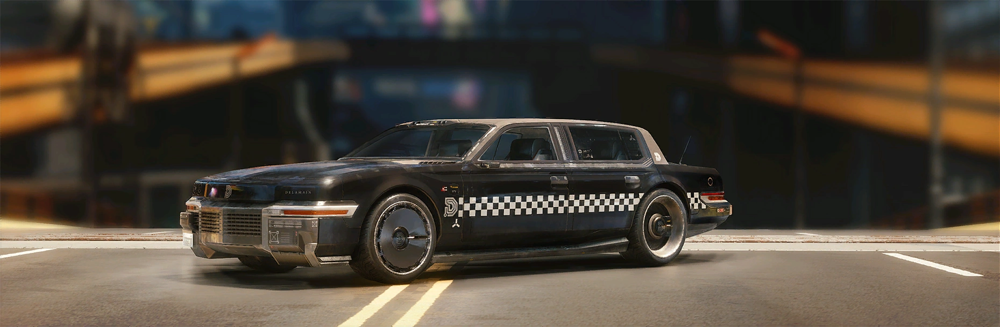

# Predicting the duration of a taxi trip

## 1. Постановка задачи

<center> <img src=https://storage.googleapis.com/kaggle-media/competitions/kaggle/3333/media/taxi_meter.png
align="right" width="300"/> </center>
    
Нам предстоит решить настоящую задачу машинного обучения, направленную на автоматизацию бизнес процессов. Мы построим модель, которая будет предсказывать общую продолжительность поездки такси в Нью-Йорке.

Представим, мы заказываем такси из одной точки Нью-Йорка в другую, причем не обязательно конечная точка должна находиться в пределах города. Сколько мы должны будем за нее заплатить? Известно, что стоимость такси в США  рассчитывается на основе фиксированной ставки + тарифная стоимость, величина которой зависит от времени и расстояния. Тарифы варьируются в зависимости от города.

В свою очередь время поездки зависит от множества факторов таких как, откуда и куда мы едем, в какое время суток мы совершаем нашу поездку, погодных условий и так далее. 

Таким образом, если мы разработаем алгоритм, способный определять длительность поездки, то сможем прогнозировать ее стоимость самым тривиальным образом, например, просто умножая стоимость на заданный тариф.

Сервисы такси хранят огромные объёмы информации о поездках, включая такие данные как конечная, начальная точка маршрута, дата поездки и ее длительность. Эти данные можно использовать для того, чтобы прогнозировать длительность поездки в автоматическом режиме с привлечением искусственного интеллекта.

**Бизнес-задача:** определить характеристики и с их помощью спрогнозировать длительность поездки такси.

**Техническая задача для нас как для специалистов в Data Science:** построить модель машинного обучения, которая на основе предложенных характеристик клиента будет предсказывать числовой признак - время поездки такси. То есть решить задачу регрессии.

**Основные цели проекта:**
1. Сформировать набор данных на основе нескольких источников информации
2. Спроектировать новые признаки с помощью Feature Engineering и выявить наиболее значимые при построении модели
3. Исследовать предоставленные данные и выявить закономерности
4. Построить несколько моделей и выбрать из них наилучшую по заданной метрике
5. Спроектировать процесс предсказания времени длительности поездки для новых данных

В довершение загрузим эту раобту на платформу Kaggle, тем самым поучаствовав в настоящем Data Science соревновании.
Во время выполнения проекта мы также отработаем навыки работы с несколькими источниками данных, генерации признаков, разведывательного анализа и визуализации данных, отбора признаков и, конечно же, построения моделей машинного обучения!

---

## 2. Знакомство с данными, базовый анализ и расширение данных

Начнём наше исследование со знакомства с предоставленными данными. А также подгрузим дополнительные источники данных и расширим наш исходный датасет. 

Заранее импортируем модули, которые нам понадобятся для решения задачи:

In [1]:
# Для работы с данными
import numpy as np
import pandas as pd
# Для построения моеделй
from scipy import stats
import statsmodels.api as sm
from sklearn import linear_model
from sklearn import preprocessing
from sklearn import model_selection
from sklearn import tree
from sklearn import ensemble
from sklearn import metrics
from sklearn import cluster
from sklearn import feature_selection
import xgboost as xgb
from catboost import CatBoostRegressor
# Для графики и отображения
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import folium
%matplotlib inline
plt.style.use('seaborn-v0_8')
import warnings
warnings.filterwarnings('ignore')

Прочитаем наш файл с исходными данными:

In [2]:
taxi_data = pd.read_csv("data/train.zip")
print('Train data shape: {}'.format(taxi_data.shape))
taxi_data.head()

Train data shape: (1458644, 11)


,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


Итак, в датасете почти полтора миллиона записей и 11 признаков.

Условно разделим признаки на несколько групп. Каждой из групп мы в дальнейшем уделим отдельное внимание.

**Данные о клиенте и таксопарке:**
* id - уникальный идентификатор поездки;
* vendor_id - уникальный идентификатор поставщика (таксопарка), связанного с записью поездки.

**Временные характеристики:**
* pickup_datetime - дата и время, когда был включен счетчик поездки;
* dropoff_datetime - дата и время, когда счетчик был отключен.

**Географическая информация:**
* pickup_longitude -  долгота, на которой был включен счетчик;
* pickup_latitude - широта, на которой был включен счетчик;
* dropoff_longitude - долгота, на которой счетчик был отключен;
* dropoff_latitude - широта, на которой счетчик был отключен.

**Прочие признаки:**
* passenger_count - количество пассажиров в транспортном средстве (введенное водителем значение);
* store_and_fwd_flag - флаг, который указывает, сохранилась ли запись о поездке в памяти транспортного средства перед отправкой поставщику (Y - хранить и пересылать, N - не хранить и не пересылать поездку).

**Целевой признак:**
* trip_duration - продолжительность поездки в секундах.


Для начала мы проведем базовый анализ того, насколько данные готовы к дальнейшей предобработке и анализу. Посмотрим сперва на временные рамки, в которых мы работаем с данными.

Переведем признак pickup_datetime в тип данных datetime с форматом год-месяц-день час:минута:секунда. Второй временной признак (dropoff_datetime) переводить не будем, позднее мы его вовсе удалим — во избежание утечки данных.

In [3]:
taxi_data['pickup_datetime'] = pd.to_datetime(taxi_data['pickup_datetime'], format='%Y-%m-%d %H:%M:%S')
taxi_data['pickup_datetime'].min(), taxi_data['pickup_datetime'].max()

(Timestamp('2016-01-01 00:00:17'), Timestamp('2016-06-30 23:59:39'))

Посмотрим на пропуски. 

In [4]:
taxi_data.isna().sum().max()

0

Пропусков в данных нет - одной проблемой меньше.

Посмотрим на статистические характеристики некоторых признаков.

In [5]:
taxi_data.describe().round()

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration
count,1458644.0,1458644.0,1458644.0,1458644.0,1458644.0,1458644.0,1458644.0
mean,2.0,2.0,-74.0,41.0,-74.0,41.0,959.0
std,0.0,1.0,0.0,0.0,0.0,0.0,5237.0
min,1.0,0.0,-122.0,34.0,-122.0,32.0,1.0
25%,1.0,1.0,-74.0,41.0,-74.0,41.0,397.0
50%,2.0,1.0,-74.0,41.0,-74.0,41.0,662.0
75%,2.0,2.0,-74.0,41.0,-74.0,41.0,1075.0
max,2.0,9.0,-61.0,52.0,-61.0,44.0,3526282.0


In [6]:
taxi_data.describe(include='object')

,id,dropoff_datetime,store_and_fwd_flag
count,1458644,1458644,1458644
unique,1458644,1380377,2
top,id2875421,2016-02-19 19:25:04,N
freq,1,5,1450599


В данных присутствуют поездки, продолжительность которых составляет одну секунду, а также поездки, продолжительность которых больше 40 дней. Это явно выбросы.

При дальнейшем анализе выяснится также, что у нас также есть «телепортации» — поездки, которые были проделаны за секунды на большие расстояния. Но всему своё время.

Чтобы однозначно обозначить такие записи в таблице как выбросы, нам необходимо произвести более глубокий анализ данных с подключением дополнительной информации.

На основе полученной статистической информации о целевом признаке trip_duration мы также делаем важный вывод, что использование среднего в качестве центральной меры распределения длительности поездок будет грубой ошибкой. Лучше всего подойдут меры, не зависящие от выбросов, такие как усечённое среднее, логарифмическое среднее или медиана. При проведении исследований мы будем использовать медиану, а наша метрика качества моделей будет завязана на логарифмическом среднем.

А пока займемся расширением исходного набора данных как с помощью внешних источников, так и с помощью манипуляций над имеющимися в данных признаками. 

Так как все манипуляции над данными мы будем применять как с тренировочным, так и с тестовым набором данных, во избежание дублирования кода мы будем производить предобработку с помощью функций. Также применение функций позволит нам сделать код гораздо более эстетичным и читабельным.

Начнём с временных характеристик. Как нам уже известно, хранить дату и время в формате datetime как категориальный признак редко имеет смысл, поэтому их разбивают на отдельные признаки. Эти признаки могут как стать основными факторами при построении модели, так и быть вспомогательными для извлечения информации из других таблиц.

In [7]:
def add_datetime_features(df: pd.DataFrame) -> pd.DataFrame:
    """
    Функция для преобразования временных данных в новые признаки.
    Args:
        df (pd.DataFrame): исходный датасет.
    Returns:
        pd.DataFrame: расширенный новыми признаками датасет.
    """
    
    df['pickup_date'] = df['pickup_datetime'].dt.date
    df['pickup_hour'] = df['pickup_datetime'].dt.hour
    df['pickup_day_of_week'] = df['pickup_datetime'].dt.day_name()
    
    return df

add_datetime_features(taxi_data)

# Проверим результат работы функции
print(f"Число поездок в субботу: {taxi_data[taxi_data['pickup_day_of_week'] == 'Saturday'].count()[0]}")
print(f"Среднее число поездок в день: {round(taxi_data.groupby('pickup_date').count().mean()[0])}")

Число поездок в субботу: 220868
Среднее число поездок в день: 8015


От того, является ли день праздничным, часто зависит ситуация на дорогах. Большое количество автомобилей создаёт пробки и потенциально увеличивает длительность совершаемой на такси поездки.

Давайте добавим в наш датасет информацию о том, является ли день праздничным. Для этого мы собрали даты всех праздничных дней в Америке за 2016 год. Данные представлены в табличном формате CSV и содержат три столбца:
 * day — день недели;
 * date — дата;
 * holiday — наименование праздника.

In [8]:
holiday_data = pd.read_csv('data/holiday_data.csv', sep=';')
holiday_data['date'] = pd.to_datetime(holiday_data['date']).dt.date

def add_holiday_features(df1: pd.DataFrame, df2: pd.DataFrame) -> pd.DataFrame:
    """
    Функция для создания признака праздничного дня.
    Args:
        df1 (pd.DataFrame): исходный датасет;
        df2 (pd.DataFrame): датасет праздничных дней.
    Returns:
        pd.DataFrame: расширенный новым признаком датасет.
    """
    
    df1['pickup_holiday'] = df1['pickup_date'].apply(
        lambda x: 1 if x in list(df2['date']) else 0
    )
    
    return df1

add_holiday_features(taxi_data, holiday_data)

# Проверим результат работы функции
print('Медианная длительность поездки на такси в праздничные дни: ', end='')
print(round(taxi_data[taxi_data['pickup_holiday'] == 1]['trip_duration'].median()), 'с.')

Медианная длительность поездки на такси в праздничные дни: 585 с.


Теперь, когда мы разобрались с временными характеристиками, переходим к географическим.

В данных есть столбцы, содержащие информацию о широте и долготе. Из них можно извлечь очень много полезной информации.

Например, зная широту и долготу начальной и конечной точек маршрута, мы можем воспользоваться OSRM API.

[OSRM (Open Source Routing Machine)](https://en.wikipedia.org/wiki/Open_Source_Routing_Machine) — это открытый бесплатный ресурс, который активно используется во многих сервисах, предполагающих построение кратчайшего маршрута. Он позволяет построить оптимальный кусочно-линейный путь из точки А в точку B, а также узнать его примерную длительность и длину. У данного сервиса есть API ([документация](https://www.thinkdatascience.com/post/2020-03-03-osrm/osrm/)).

Проблема заключается в том, что, так как в наших данных содержится информация о более чем одном миллионе поездок, подгрузка данных с помощью API и их предобработка может занять несколько часов, а при слабом интернет-соединении — и дней. Поэтому мы заранее подготовили выгрузку данных из OSRM API для каждой поездки из тренировочной и тестовой выборок нашего набора данных.

Наборы данных представлены в табличном формате CSV. Нас будут интересовать только следующие столбцы:
 * id — идентификатор поездки;
 * total_distance — кратчайшее дорожное расстояние (в метрах) из точки, в которой был включён счётчик, до точки, в которой счётчик был выключен (согласно OSRM);
 * total_travel_time — наименьшее время поездки (в секундах) из точки, в которой был включён счётчик, до точки, в которой счётчик был выключен (согласно OSRM);
 * number_of_steps — количество дискретных шагов, которые должен выполнить водитель (поворот налево/поворот направо/ехать прямо и т. д.).

In [9]:
osrm_data = pd.read_csv('data/osrm_data_train.zip')

def add_osrm_features(df: pd.DataFrame, osrm_df: pd.DataFrame) -> pd.DataFrame:
    """
    Функция для встраивания osrm-признаков.
    Args:
        df (pd.DataFrame): исходный датасет;
        osrm_df (pd.DataFrame): osrm-датасет.
    Returns:
        pd.DataFrame: расширенный новыми признаками датасет.
    """
    
    osrm_ftrs = [
        'id', 'total_distance',
        'total_travel_time', 'number_of_steps'
    ]
    df = df.merge(
        osrm_df[osrm_ftrs],
        on='id',
        how='left'
    )
    
    return df

taxi_data = add_osrm_features(taxi_data, osrm_data)

# Проверим результат работы функции
print('Разница медиан признаков, характеризующих длительность поздок: ', end='')
print(taxi_data['trip_duration'].median() - taxi_data['total_travel_time'].median(), 'c.')
print('Число строк с пропусками в новых данных:', taxi_data.isna().sum().max())

Разница медиан признаков, характеризующих длительность поздок: 372.5 c.
Число строк с пропусками в новых данных: 1


Время поездки, вычисляемое с помощью OSRM, не является истинным временем поездки, так как оно вычисляется по кратчайшему пути при идеальных условиях: отсутствие пробок, погодных влияний и других внешних факторов. Если воспользоваться этим временем поездки как предсказанием, наша ошибка прогноза будет довольно велика по сравнению с той, которую мы получим при использовании моделей машинного обучения.

С помощью географических характеристик можно извлечь ещё немного информации. Если рассматривать Землю как сферу, то, зная широту и долготу начальной и конечной точек маршрута, можно вычислить географическое расстояние между точками на сфере, а также узнать направление движения автомобиля.

In [10]:
def get_haversine_distance(lat1, lng1, lat2, lng2) -> float:
    """
    Функция для вычисления расстояния по формуле гаверсинуса (в километрах).
    Args:
        lat1 (float): широта начальной точки;
        lng1 (float): долгота начальной точки;
        lat2 (float): широта конечной точки;
        lng2 (float): долгота конечной точки.
    Returns:
        float: расстояние между двумя точками на сфере (в километрах).
    """
    
    # переводим углы в радианы
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    # радиус земли в километрах
    EARTH_RADIUS = 6371
    # считаем кратчайшее расстояние h по формуле Хаверсина
    lat_delta = lat2 - lat1
    lng_delta = lng2 - lng1
    d = np.sin(lat_delta * 0.5) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(lng_delta * 0.5) ** 2
    h = 2 * EARTH_RADIUS * np.arcsin(np.sqrt(d))
    
    return h

def get_angle_direction(lat1, lng1, lat2, lng2) -> float:
    """
    Функция для вычисления угла направления движения (в градусах).
    Args:
        lat1 (float): широта начальной точки;
        lng1 (float): долгота начальной точки;
        lat2 (float): широта конечной точки;
        lng2 (float): долгота конечной точки.
    Returns:
        float: угол направления движения от первой точки ко второй (в радианах).
    """
    
    # переводим углы в радианы
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    # считаем угол направления движения alpha по формуле угла пеленга
    lng_delta_rad = lng2 - lng1
    y = np.sin(lng_delta_rad) * np.cos(lat2)
    x = np.cos(lat1) * np.sin(lat2) - np.sin(lat1) * np.cos(lat2) * np.cos(lng_delta_rad)
    alpha = np.degrees(np.arctan2(y, x))
    
    return alpha

def add_geographical_features(df: pd.DataFrame) -> pd.DataFrame:
    """
    Функция для встраивания географических признаков.
    Args:
        df (pd.DataFrame): исходный датасет.
    Returns:
        pd.DataFrame: расширенный новыми признаками датасет.
    """
    
    lat1, lat2 = df['pickup_latitude'].values, df['dropoff_latitude'].values
    lng1, lng2 = df['pickup_longitude'].values, df['dropoff_longitude'].values
    df['haversine_distance'] = get_haversine_distance(lat1, lng1, lat2, lng2)
    df['direction'] = get_angle_direction(lat1, lng1, lat2, lng2)
    
    return df

А теперь применим наши функции.

In [11]:
taxi_data = add_geographical_features(taxi_data)
# Проверим результат работы функций
print('Медианное расстояние Хаверсина: ', end='')
print(round(taxi_data['haversine_distance'].median(), 2), 'км.')

Медианное расстояние Хаверсина: 2.09 км.


Следующая методика манипуляций с географическими данными — это применение кластеризации по географическим координатам. Идея заключается в том, чтобы сгруппировать все поездки в зависимости от координат начала и конца поездки с помощью методов кластеризации, тем самым добавив информацию о районах, в которых находятся точки старта и конца поездки.

Гипотеза состоит в том, что длительность поездки будет зависеть от того, к какому географическому кластеру будет принадлежать поездка.

В качестве метода кластеризации воспользуемся алгоритмом K-Means. Возьмём 15 кластеров и обучим его на данных, сформированных из широты и долготы всех точек начала и конца поездок.

In [12]:
# Создаем обучающую выборку из географических координат всех точек
coords = np.hstack((
    taxi_data[['pickup_latitude', 'pickup_longitude']],
    taxi_data[['dropoff_latitude', 'dropoff_longitude']].values
))

# Обучаем алгоритм кластеризации
kmeans = cluster.KMeans(n_clusters=15, random_state=42, n_init=10)
kmeans.fit(coords)

def add_cluster_features(df, cluster_model) -> pd.DataFrame:
    """
    Функция для встраивания кластерного признака.
    Args:
        df (pd.DataFrame): исходный датасет;
        cluster_model (sklearn.cluster._kmeans.KMeans): обученный
        алгоритм кластеризации.
    Returns:
        pd.DataFrame: расширенный новым признаком датасет.
    """
    
    df['geo_cluster'] = cluster_model.predict(
        df[['pickup_latitude', 'pickup_longitude',
        'dropoff_latitude', 'dropoff_longitude']].values
    )
    
    return df

taxi_data = add_cluster_features(taxi_data, kmeans)
# Проверим результат работы функции
print('Число поездок в наименьшем кластере: ', end='')
print(taxi_data['geo_cluster'].value_counts().min())

Число поездок в наименьшем кластере: 2


Другим важным фактором, потенциально влияющим на дорожное движение, является погода. Так, например, логично предположить, что снег и дождь могут затруднять движение и увеличивать время поездки.

Поэтому мы взяли датасет, содержащий информацию о погодных условиях в Нью-Йорке в 2016 году. Он представлен в табличном формате CSV. Нас будут интересовать только следующие столбцы:

 - time — дата измерения (с интервалом в час);
 - temperature — температура;
 - visibility — видимость;
 - wind speed — средняя скорость ветра;
 - precip — количество осадков;
 - events — погодные явления: Rain — дождь, Snow — снег, Fog — туман, None — отсутствие погодных явлений.

In [13]:
weather_data = pd.read_csv('data/weather_data.zip')

def add_weather_features(df, weather_df) -> pd.DataFrame:
    """
    Функция для встраивания погодных признаков.
    Args:
        df (pd.DataFrame): исходный датасет;
        weather_df (pd.DataFrame): датасет с данными о погоде.
    Returns:
        pd.DataFrame: расширенный новым признаком датасет.
    """
    
    weather_df['time'] = pd.to_datetime(weather_df['time'])
    weather_df['date'] = weather_df['time'].dt.date
    weather_df['hour'] = weather_df['time'].dt.hour
    
    weather_cols = [
        'date', 'hour', 'temperature', 'visibility',
        'wind speed', 'precip', 'events'
    ]
    
    df = df.merge(
        weather_df[weather_cols],
        left_on=['pickup_date', 'pickup_hour'],
        right_on=['date', 'hour'],
        how='left'
    )
    df = df.drop(['date', 'hour'], axis=1)
    
    return df

taxi_data = add_weather_features(taxi_data, weather_data)
# Проверим результат работы функции
print('В снежную погоду было совершено', end=' ')
print(taxi_data['events'].value_counts()['Snow'], 'поездок.')
print('Число строк с пропусками:', end=' ')
print(taxi_data.isnull().sum().max())

В снежную погоду было совершено 13126 поездок.
Число строк с пропусками: 12032


В результате объединения у нас получились записи, для которых в столбцах temperature, visibility, wind speed, precip, и events имеются пропуски. Это связано с тем, что в таблице с данными о погодных условиях отсутствуют измерения для некоторых моментов времени, в которых включался счетчик поездки.

Поэтому нам теперь необходимо немного подчистить датасет. Пропуски в столбцах с погодными условиями заполним медианными значениями температуры, влажности, скорости ветра и видимости в зависимости от даты начала поездки. Для этого сгруппируем данные по столбцу pickup_date и рассчитаем медиану в каждой группе, после чего с помощью комбинации методов transform() и fillna() заполним пропуски.

Пропуски в столбце events заполним строкой 'None'. Пропуски в столбцах с информацией из OSRM API - total_distance, total_travel_time и number_of_steps заполним медианным значением по столбцам.

In [14]:
def fill_null_weather_data(df) -> pd.DataFrame:
    """
    Функция для заполнения пропусков.
    Args:
        df (pd.DataFrame): исходный датасет.
    Returns:
        pd.DataFrame: расширенный новыми признаками датасет.
    """
    
    weather_cols = [
        'temperature', 'visibility',
        'wind speed', 'precip', 'events'
    ]
    osrm_cols = [
        'total_distance',
        'total_travel_time',
        'number_of_steps'
    ]
    
    for col in weather_cols:
        if col == 'events':
            df['events'] = df['events'].fillna('None')
        else:
            df[col] = df[col].fillna(
                df.groupby('pickup_date')[col].transform('median')
            )
    
    for col in osrm_cols:
        df[col] = df[col].fillna(df[col].median())
        
    return df

taxi_data = fill_null_weather_data(taxi_data)
# Проверим результат работы функции
print('Медианная температура: ', end=' ')
print(round(taxi_data['temperature'].median(), 1))

Медианная температура:  11.1


В довершение данной части найдем очевидные выбросы в целевой переменной - длительности поездки. 

Проще всего найти слишком продолжительные поездки. Условимся, что выбросами будут считаться поездки, длительность которых превышает 12 часов. 

Чуть сложнее с анализом поездок, длительность которых слишком мала. Потому что к ним относятся действительно реальные поездки на короткие расстояния, поездки, которые были отменены через секунду после того как включился счетчик, а также “телепортации” - перемещение на большие расстояния за считанные секунды. Условимся, что мы будем считать выбросами только последнюю группу.

Наиболее простой способ их обнаружения - воспользоваться информацией о кратчайшем расстоянии, которое проезжает такси. Вычислить среднюю скорость автомобиля на кратчайшем пути следующим образом:

$$avg\_speed= \frac{total\_distance}{1000*trip\_duration}*3600$$

Если мы построим диаграмму рассеяния средней скорости движения автомобилей, мы увидим следующую картину:

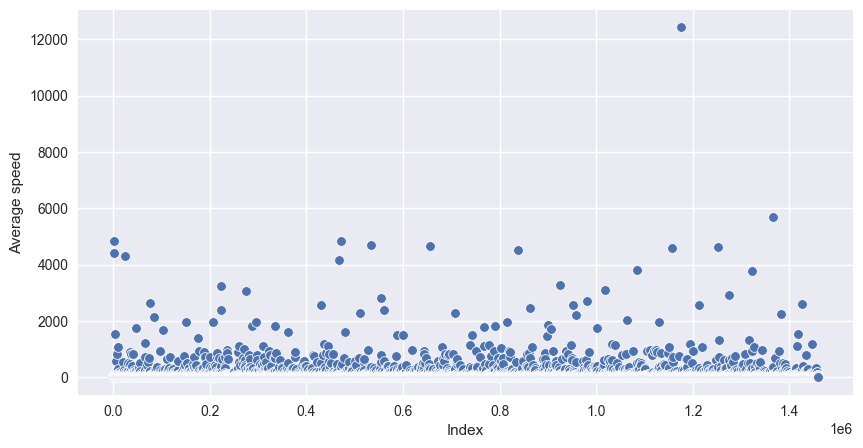

In [15]:
avg_speed = taxi_data['total_distance'] / taxi_data['trip_duration'] * 3.6
fig, ax = plt.subplots(figsize=(10, 5))
sns.scatterplot(x=avg_speed.index, y=avg_speed, ax=ax)
ax.set_xlabel('Index')
ax.set_ylabel('Average speed');

Как раз отсюда мы видим, что у нас есть 'поездки-телепортации', для которых средняя скорость более 1000 км/ч. Даже есть такая, средняя скорость которой составляла более 12000 км/ч! Условимся, что предельная средняя скорость, которую могут развивать таксисты будет 250 км/ч: вряд ли Нью-Йорк и его окрестности позволяют разогнаться сильнее.

In [16]:
outliers_duration = list(taxi_data[taxi_data['trip_duration'] > 3600*12].index)
outliers_speed = list(taxi_data[avg_speed > 250].index)

print(f'Outliers in trip duration (>12 hours): {len(outliers_duration)}')

print(f'Outliers in average speed (>250 km/h): {len(outliers_speed)}')

taxi_data = taxi_data.drop(outliers_duration+outliers_speed)
print(f'Cleaned data shape: {taxi_data.shape[0]}')

Outliers in trip duration (>12 hours): 1993
Outliers in average speed (>250 km/h): 481
Cleaned data shape: 1456170


---

## 3. Разведывательный анализ данных (EDA)

В этой части нашего проекта мы:
* Исследуем сформированный набор данных; 
* Попробуем найти закономерности, позволяющие сформулировать предварительные гипотезы относительно того, какие факторы являются решающими в определении длительности поездки;
* Дополним наш анализ визуализациями, иллюстрирующими исследование.

Начинаем с целевого признака. Забегая вперед, скажем, что основной метрикой качества решения поставленной задачи будет RMSLE - Root Mean Squared Log Error, которая вычисляется на основе целевой переменной в логарифмическом масштабе. В таком случае целесообразно сразу логарифмировать признак длительности поездки и рассматривать при анализе логарифм в качестве целевого признака:

$$trip\_duration\_log = log(trip\_duration+1),$$

где под символом log подразумевается натуральный логарифм.

In [17]:
taxi_data['trip_duration_log'] = np.log(taxi_data['trip_duration']+1)

Построим гистограмму и коробчатую диаграмму длительности поездок в логарифмическом масштабе (trip_duration_log). 
Исходя из визуализации, сделаем предположение, является ли полученное распределение нормальным.
Проверим нашу гипотезу с помощью теста Д’Агостино при уровне значимости $\alpha=0.05$. 

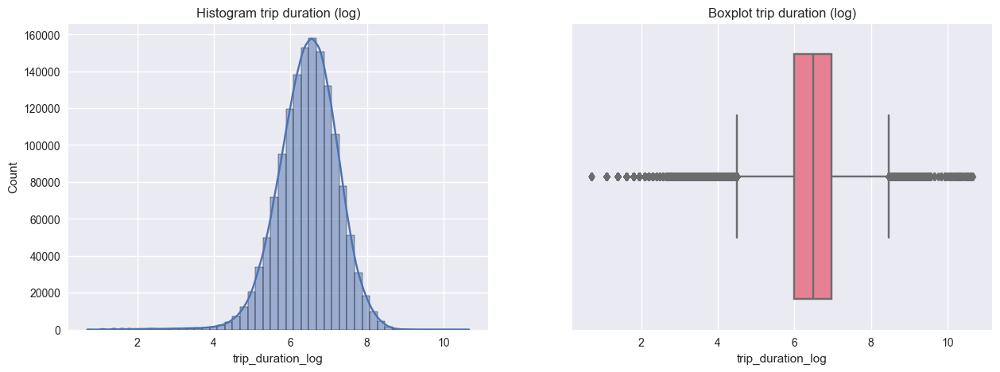

In [18]:
# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
# Рисуем гистограмму
sns.histplot(
    data=taxi_data,
    x='trip_duration_log',
    ax=ax[0],
    bins=50,
    kde=True,
    palette='husl'
)
ax[0].set_title('Histogram trip duration (log)')
# Рисуем коробчатую диаграмму
sns.boxplot(
    data=taxi_data,
    x='trip_duration_log',
    ax=ax[1],
    palette='husl'
)
ax[1].set_title('Boxplot trip duration (log)');

На неискушенный взгляд распределение кажется вполне нормальным. Смущает только обилие выбросов и разность длин хвостов.

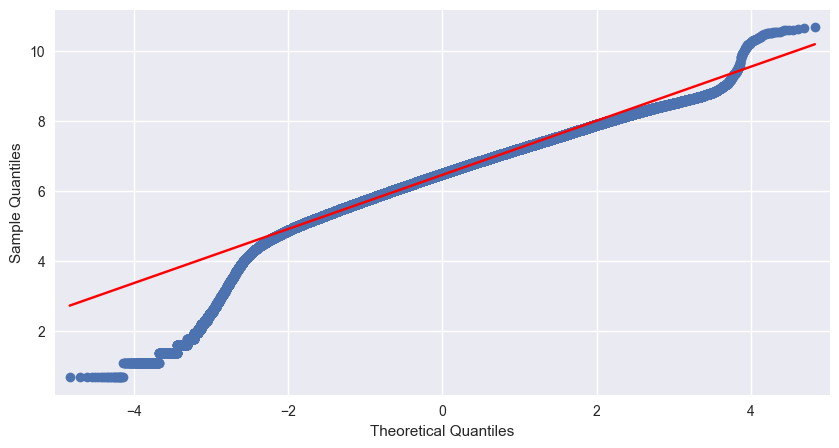

In [19]:
# Рисуем q-q график
fig, ax = plt.subplots(figsize=(10, 5))
sm.qqplot(data=taxi_data['trip_duration_log'], line='s', ax=ax);

Да, похоже, именно хвосты и не позволят нам увериться в нормальности. Проведем все же контрольный тест.

In [20]:
# Проверяем гипотезу о нормальном распределении
H0 = 'Данные распределены нормально.'
H1 = 'Данные не распределены нормально (отвергаем H0).'
alpha = 0.05

_, p_value = stats.normaltest(taxi_data['trip_duration_log'])

print(f'p-value: {round(p_value, 3)}')
print(H0) if p_value > alpha/2 else print(H1)

p-value: 0.0
Данные не распределены нормально (отвергаем H0).


Построим визуализацию, которая позволит сравнить распределение длительности поездки в логарифмическом масштабе (trip_duration_log) в зависимости от таксопарка (vendor_id). Сравним два распределения между собой.

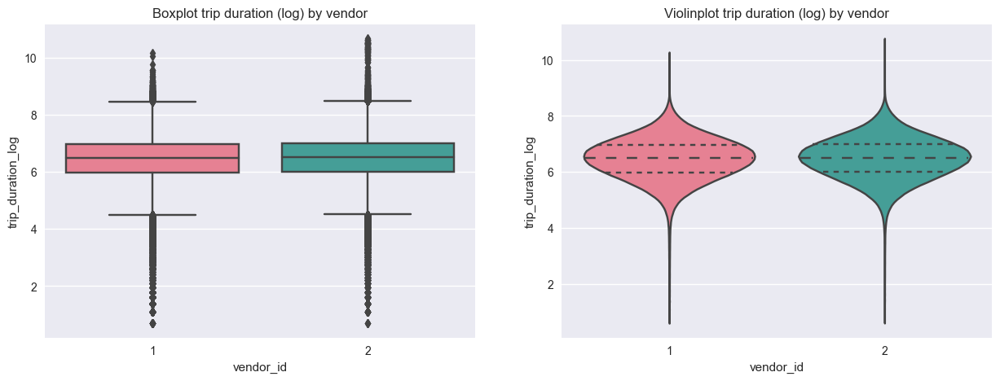

In [21]:
# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
# Рисуем коробчатую диаграмму
sns.boxplot(
    data=taxi_data,
    y='trip_duration_log',
    x='vendor_id',
    palette='husl',
    ax=ax[0]
)
# Рисуем скрипки
sns.violinplot(
    data=taxi_data,
    y='trip_duration_log',
    x='vendor_id',
    palette='husl',
    ax=ax[1],
    inner='quart'
)
ax[0].set_title('Boxplot trip duration (log) by vendor')
ax[1].set_title('Violinplot trip duration (log) by vendor');

Очень похоже, что значимая зависимость от таксопарка отсутствует. Но еще пару графиков мы все же нарисуем.

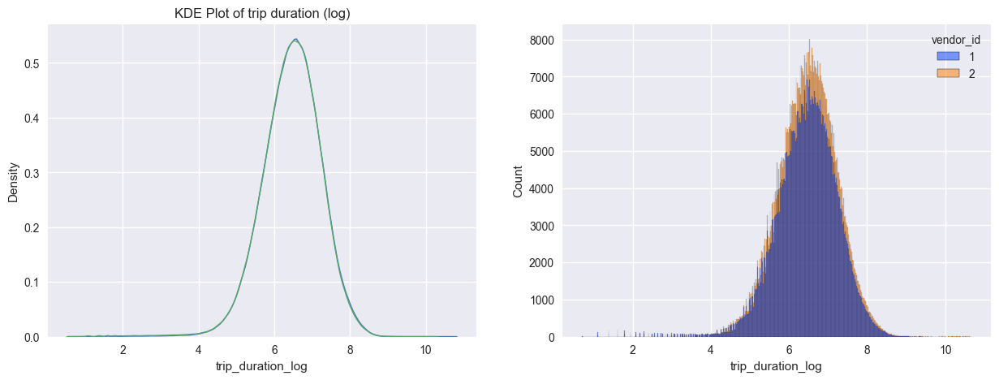

In [22]:
# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
vendors = taxi_data['vendor_id'].value_counts().index.tolist()
for v in vendors: 
    subset = taxi_data[taxi_data['vendor_id'] == v]
    # Рисуем грфик оценки плотности ядра для каждого таксопарка
    sns.kdeplot(
        subset['trip_duration_log'],
        label=v, linewidth=1, palette='bright', ax=ax[0]
    )
ax[0].set_title('KDE Plot of trip duration (log)') 

# Рисуем блошиную гистограмму
sns.histplot(
    taxi_data, x="trip_duration_log",
    hue="vendor_id", palette='bright', ax=ax[1]
);

KDE графики практически совпадают. Гистограмма показывает лишь незначительное преобладание доли данных от второго таксопарка при совпадении контуров получившихся фигур.

Построим визуализацию, которая позволит сравнить распределение длительности поездки в логарифмическом масштабе (trip_duration_log) в зависимости от признака отправки сообщения поставщику (store_and_fwd_flag). 

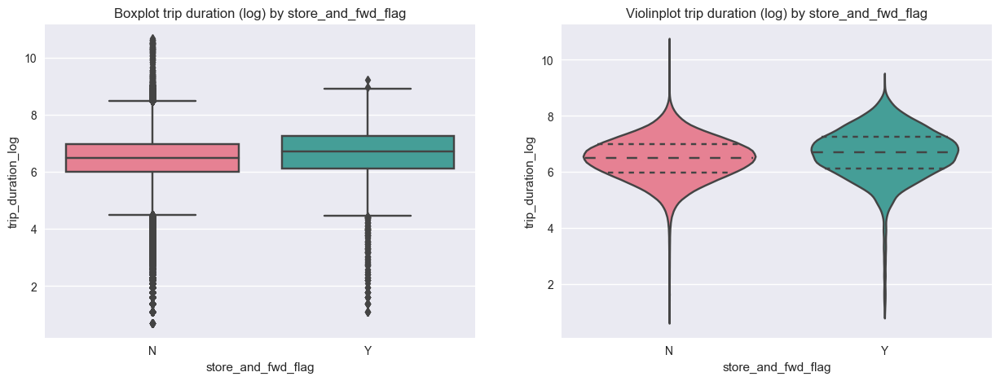

In [23]:
# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
# Рисуем коробчатую диаграмму
sns.boxplot(
    data=taxi_data,
    y='trip_duration_log',
    x='store_and_fwd_flag',
    palette='husl',
    ax=ax[0]
)
# Рисуем скрипки
sns.violinplot(
    data=taxi_data,
    y='trip_duration_log',
    x='store_and_fwd_flag',
    palette='husl',
    ax=ax[1],
    inner='quart'
)
ax[0].set_title('Boxplot trip duration (log) by store_and_fwd_flag')
ax[1].set_title('Violinplot trip duration (log) by store_and_fwd_flag');

Если внимательно присмотреться к распределению длительности поездок в зависимости от признака store_and_fwd_flag, становится ясно, что наиболее длительные поездки принадлежат к группе N (не хранить и не пересылать поездку). Таким образом, флаг сохраняется только для кратковременных поездок, а для аномальных многочасовых — не сохраняется.

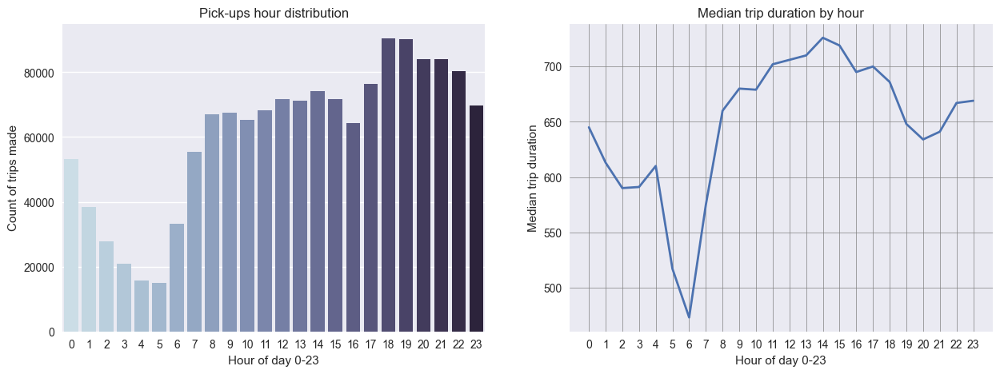

In [24]:
# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(15, 5))
# Рисуем график подсчета
sns.countplot(
    data=taxi_data,
    x='pickup_hour',
    ax=ax[0],
    palette='ch:s=.25,rot=-.25'
)
ax[0].set_title('Pick-ups hour distribution')
ax[0].set_xlabel('Hour of day 0-23')
ax[0].set_ylabel('Count of trips made')
# Группируем данные по часам поездок и рассчитываем медианы
median_duration_hour = taxi_data.groupby(
    ['pickup_hour'])['trip_duration'].median().reset_index().rename(
    columns={'trip_duration': 'median_trip_duration'}
)
# Рисуем линейный график
sns.lineplot(
    data=median_duration_hour,
    x='pickup_hour',
    y='median_trip_duration',
    lw=2,
    ax=ax[1]
)
ax[1].set_title('Median trip duration by hour')
ax[1].set_xlabel('Hour of day 0-23')
ax[1].set_ylabel('Median trip duration')
ax[1].grid(linestyle='-', linewidth=0.5, color='grey')
ax[1].set_xticks(taxi_data['pickup_hour'].unique());

Реже всего, как видим, такси заказывают рано утром - часов в 4-5. Пик медианной длительности поездок приходится на два часа пополудни.

Построим две визуализации:
* Распределение количества поездок в зависимости от дня недели;
* Зависимость медианной длительности поездки от дня недели.

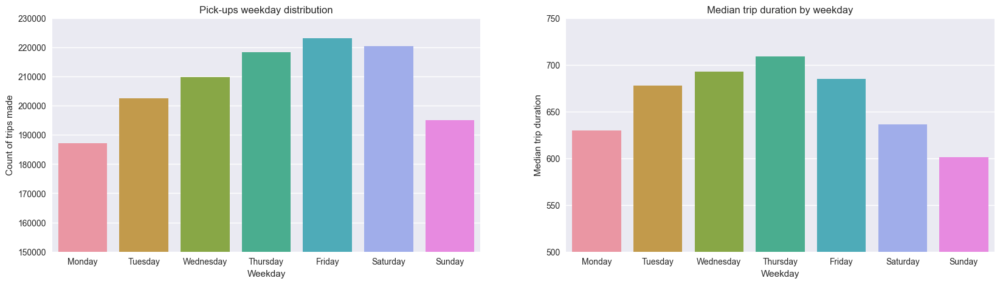

In [25]:
# Задаем порядок отображения
ordered_day = [
    'Monday', 'Tuesday', 'Wednesday', 'Thursday',
    'Friday', 'Saturday', 'Sunday'
]
# Зададим фигуру и поля
fig, ax = plt.subplots(1, 2, figsize=(20, 5))
# Рисуем график подсчета
sns.countplot(
    data=taxi_data,
    x='pickup_day_of_week',
    order=ordered_day,
    ax=ax[0]
)
ax[0].set_title('Pick-ups weekday distribution')
ax[0].set_xlabel('Weekday')
ax[0].set_ylabel('Count of trips made')
ax[0].set_ylim(15*10e3, 23*10e3)
# Группируем данные по дням недели и выводим медианы длительностей поездок
median_duration_day = taxi_data.groupby(
    ['pickup_day_of_week'])['trip_duration'].median().reset_index().rename(
    columns={'trip_duration': 'median_trip_duration'})
# Рисуем гистограмму
sns.barplot(
    data=median_duration_day,
    x='pickup_day_of_week',
    y='median_trip_duration',
    order=ordered_day,
    ax=ax[1]
)
ax[1].set_title('Median trip duration by weekday')
ax[1].set_xlabel('Weekday')
ax[1].set_ylabel('Median trip duration')
ax[1].set_ylim(500, 750);

Больше всего поездок приходится на пятницу. Наиболее длительные поездки происходили в четверг.

Посмотрим теперь на обе временные характеристики одновременно. Построим сводную таблицу, по столбцам которой будут отложены часы (pickup_hour), по строкам - дни недели (pickup_day_of_week), а в ячейках - медианная длительность поездки (trip_duration). Визуализируем полученную сводную таблицу с помощью тепловой карты.

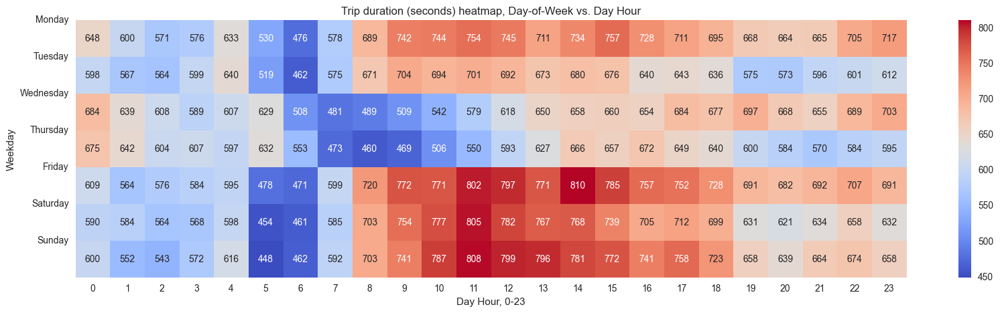

In [26]:
# Построим сводную таблицу
pivot_data = taxi_data.pivot_table(
    values='trip_duration',
    index='pickup_day_of_week',
    columns='pickup_hour',
    aggfunc='median'
)
# Зададим фигуру и поля
fig, ax = plt.subplots(figsize=(20, 5))
# Рисуем тепловую карту на нашей таблице
sns.heatmap(data=pivot_data, annot=True, fmt='.0f', ax=ax, cmap='coolwarm')
ax.set_title('Trip duration (seconds) heatmap, Day-of-Week vs. Day Hour')
ax.set_ylabel('Weekday')
ax.set_xlabel('Day Hour, 0-23')
plt.yticks(range(0, 7), ordered_day, rotation='horizontal'); 

Похоже, наиболее длительные поездки приходятся на два часа пополудни в пятницу. В целом же, обилие красных и красноватых квадратов в конце недели на предобеденные-послеобеденные часы говорит, возможно, также о нагруженности дорог. Наиболее скорые поездки совершаются в утренние часы выходных: вероятно, пробок в это время бывает меньше всего. Четверг и среда любопытным образом выпадают из общего тренда: возможно, это также следствие местной культуры труда.

Построим теперь две диаграммы рассеяния:
* первая должна иллюстрировать географическое расположение точек начала поездок (pickup_longitude, pickup_latitude);
* вторая - географическое расположение точек завершения поездок (dropoff_longitude, dropoff_latitude).

Для этого на диаграммах по оси абсцисс отложим широту (longitude), а по оси ординат - долготу (latitude). Включим в визуализацию только те точки, которые находятся в пределах Нью-Йорка - добавим следующие ограничения на границы осей абсцисс и ординат:
 - city_long_border = (-74.03, -73.75)
 - city_lat_border = (40.63, 40.85)

Добавим также на диаграммы расцветку по географическим кластерам (geo_cluster), которые мы сгенерировали ранее. 

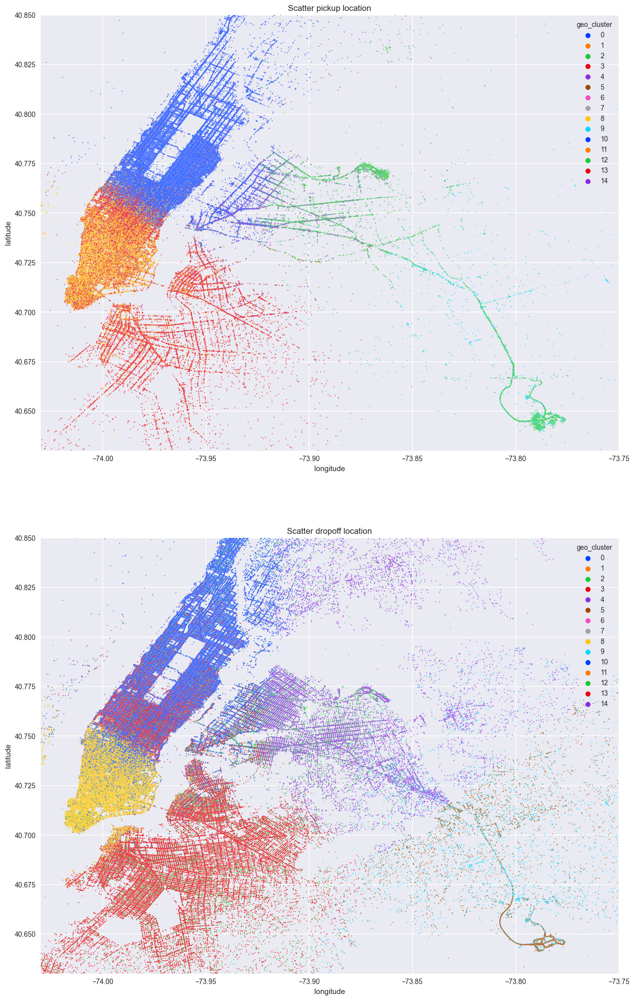

In [27]:
# Обозначим границы прямоугольника
city_long_border = (-74.03, -73.75)
city_lat_border = (40.63, 40.85)
# Зададим фигуру и поля
fig, ax = plt.subplots(2, 1, sharey=True, figsize=(15, 25))
# Рисуем первую диаграмму рассеяния
sns.scatterplot(
    data=taxi_data,
    x='pickup_longitude',
    y='pickup_latitude',
    hue='geo_cluster',
    s=2,
    palette='bright',
    alpha=.8,
    ax=ax[0]
)
ax[0].set_title('Scatter pickup location')
ax[0].set_xlabel('longitude')
ax[0].set_ylabel('latitude')
ax[0].set_ylim(city_lat_border)
ax[0].set_xlim(city_long_border)
# Рисуем вторую
sns.scatterplot(
    data=taxi_data,
    x='dropoff_longitude',
    y='dropoff_latitude',
    hue='geo_cluster',
    s=2,
    palette='bright',
    alpha=.8,
    ax=ax[1]
)
ax[1].set_title('Scatter dropoff location')
ax[1].set_xlabel('longitude')
ax[1].set_ylabel('latitude')
ax[1].set_ylim(city_lat_border)
ax[1].set_xlim(city_long_border);

Т.к. кластеров у нас больше, чем цветов в палитре, о качестве кластеризации мы можем судить в некоторой степени ограниченно. Но это мешает нам увидеть, насколько сильно, по сравнению с точками посадки, рассеяны точки высадки пасажиров.

Взглянем теперь на интерактивную карту расположения точек.

In [28]:
td_df = taxi_data.copy() # копируем исходный датасет и изменяем признаки
td_df['pickup_latitude_round3'] = np.round(td_df['pickup_latitude'], 3)
td_df['pickup_longitude_round3'] = np.round(td_df['pickup_longitude'], 3)
td_df['dropoff_latitude_round3'] = np.round(td_df['dropoff_latitude'], 3)
td_df['dropoff_longitude_round3'] = np.round(td_df['dropoff_longitude'], 3)
# Группируем данные по точкам посадки
pickup = td_df.groupby(
    ['pickup_latitude_round3', 'pickup_longitude_round3']
)['vendor_id'].count().reset_index().rename(columns={'id': 'Num_Trips'})
# Инициализируем карту
pickup_map = folium.Map(location=[40.730610, -73.935242], zoom_start=10)
# Проходимся в цикле по точкам посадки
for i, row in pickup.iterrows():
    location = [row['pickup_latitude_round3'], row['pickup_longitude_round3']]
    folium.CircleMarker(
        location=location,
        radius=3,
        popup=location,
        fill_color='#3db7e4',
        fill_opacity=0.9
    ).add_to(pickup_map)
# Выводим результат
pickup_map

У нас есть точка в Калифорнии, несколько точек в Атлантике, множество точек за пределами штата Нью-Йорк. Такой разбос вряд ли повлияет на точность моделей, т.к. явные выбросы мы уже удалили.

---

## 4. Отбор и преобразование признаков

Перед тем как перейти к построению модели, осталось сделать ещё несколько шагов.
* Следует помнить, что многие алгоритмы машинного обучения не могут обрабатывать категориальные признаки в их обычном виде. Поэтому нам необходимо их закодировать.
* Надо отобрать признаки, которые мы будем использовать для обучения моделей.
* Необходимо масштабировать и трансформировать некоторые признаки для того, чтобы улучшить сходимость моделей, в основе которых лежат численные методы.

In [29]:
print('Shape of data: {}'.format(taxi_data.shape))
print('Columns: {}'.format(taxi_data.columns))

Shape of data: (1456170, 27)
Columns: Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration', 'pickup_date', 'pickup_hour', 'pickup_day_of_week',
       'pickup_holiday', 'total_distance', 'total_travel_time',
       'number_of_steps', 'haversine_distance', 'direction', 'geo_cluster',
       'temperature', 'visibility', 'wind speed', 'precip', 'events',
       'trip_duration_log'],
      dtype='object')


Для удобства работы сделаем копию исходной таблицы с поездками:

In [30]:
train_data = taxi_data.copy()
train_data.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,...,number_of_steps,haversine_distance,direction,geo_cluster,temperature,visibility,wind speed,precip,events,trip_duration_log
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,...,5.0,1.498521,99.970196,10,4.4,8.0,27.8,0.3,None,6.122493
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,...,6.0,1.805507,-117.153768,8,28.9,16.1,7.4,0.0,None,6.498282
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,...,16.0,6.385098,-159.680165,8,-6.7,16.1,24.1,0.0,None,7.661527
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,...,4.0,1.485498,-172.737700,8,7.2,16.1,25.9,0.0,None,6.063785
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,...,5.0,1.188588,179.473585,0,9.4,16.1,9.3,0.0,None,6.077642


Сразу позаботимся об очевидных неинформативных и избыточных признаках: уникальный айди и время выключения таймера.

In [31]:
drop_columns = ['id', 'dropoff_datetime']

train_data = train_data.drop(drop_columns, axis=1)
print(f'Shape of data: {train_data.shape}')

Shape of data: (1456170, 25)


Ранее мы извлекли всю необходимую для нас информацию из даты начала поездки, теперь мы можем избавиться от этих признаков, так как они нам больше не понадобятся:


In [32]:
drop_columns = ['pickup_datetime', 'pickup_date']
train_data = train_data.drop(drop_columns, axis=1)
print('Shape of data:  {}'.format(train_data.shape))

Shape of data:  (1456170, 23)


Теперь займёмся кодированием категориальных признаков. В наших данных к категориальным можно отнести следующие признаки:
 - vendor_id;
 - store_and_fwd_flag;
 - pickup_day_of_week;
 - geo_cluster;
 - events.

Первые два (vendor_id и store_and_fwd_flag) из них являются бинарными.

In [33]:
train_data['vendor_id'] = train_data['vendor_id'].replace({1:0,2:1})
train_data['store_and_fwd_flag'] = train_data['store_and_fwd_flag'].replace({'N':0,'Y':1})

Создадим таблицу data_onehot из закодированных однократным кодированием признаков pickup_day_of_week, geo_cluster и events в таблице train_data с помощью OneHotEncoder из библиотеки sklearn. Параметр drop выставите в значение 'first', чтобы удалять первый бинарный столбец, тем самым не создавая излишних признаков.

В результате работы OneHotEncoder мы получим безымянный numpy-массив, который нам будет необходимо преобразовать обратно в DataFrame, для более удобной работы в дальнейшем.

In [34]:
columns_to_change = ['pickup_day_of_week', 'geo_cluster', 'events']
one_hot_encoder = preprocessing.OneHotEncoder(drop='first', sparse_output=False)

data_onehot = one_hot_encoder.fit_transform(train_data[columns_to_change])
column_names = one_hot_encoder.get_feature_names_out(columns_to_change)
data_onehot = pd.DataFrame(data_onehot, columns=column_names)
print(f'Shape of one hot data: {data_onehot.shape}')

Shape of one hot data: (1456170, 23)



Добавим полученную таблицу с закодированными признаками:

In [35]:
train_data = pd.concat(
    [train_data.reset_index(drop=True).drop(columns_to_change, axis=1), data_onehot], 
    axis=1
)
print('Shape of data: {}'.format(train_data.shape))

Shape of data: (1456170, 43)


Теперь, когда категориальные признаки предобработаны, сформируем матрицу наблюдений X, вектор целевой переменной y и его логарифм y_log. В матрицу наблюдений войдут все столбцы из таблицы с поездками за исключением целевого признака trip_duration и его логарифмированной версии trip_duration_log:


In [36]:
X = train_data.drop(['trip_duration', 'trip_duration_log'], axis=1)
y = train_data['trip_duration']
y_log = train_data['trip_duration_log']

Все наши модели мы будем обучать на логарифмированной версии y_log.

Далее нам необходимо определить тип валидации — схему, по которой мы будем оценивать качество построенных моделей. Так как наш набор данных довольно большой (почти 1.5 миллиона наблюдений), то мы свободно можем использовать hold-out-валидацию. Использование k-fold-валидации и тем более leave-one-out-валидации при таком объёме данных будет избыточным и времязатратным.

Выбранный тип валидации - hold-out. Разобьем выборку на обучающую и валидационную в соотношении 67/33:

In [37]:
X_train, X_valid, y_train_log, y_valid_log = model_selection.train_test_split(
    X, y_log, 
    test_size=0.33, 
    random_state=42
)

На данный момент у нас достаточно много признаков: скорее всего, не все из них будут важны. Попробуем оставить лишь те, которые сильнее всего связаны с целевой переменной и точно будут вносить вклад в повышение качества модели.

С помощью SelectKBest отберем 35 признаков, наилучшим образом подходящих для предсказания целевой переменной в логарифмическом масштабе.

In [38]:
selector = feature_selection.SelectKBest(
    score_func=feature_selection.f_regression,
    k=35
)
selector.fit(X_train, y_train_log)
best_features = selector.get_feature_names_out()
X_train = X_train[best_features]
X_valid = X_valid[best_features]

Так как мы будем использовать различные модели, в том числе внутри которых заложены численные методы оптимизации, то нужно заранее позаботиться о масштабировании факторов.

Нормализуем предикторы в обучающей и валидационной выборках с помощью MinMaxScaler из библиотеки sklearn.

In [39]:
scaler = preprocessing.MinMaxScaler()
scaler.fit(X_train)
X_train_scaled = scaler.transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

Отлично, теперь мы готовы к моделированию!

---

## 5. Решение задачи регрессии: линейная регрессия и деревья решений

Определим метрику, по которой мы будем измерять качество наших моделей. Мы будем следовать канонам исходного соревнования на Kaggle и в качестве метрики использовать RMSLE (Root Mean Squared Log Error), которая вычисляется как:

$$RMSLE = \sqrt{\frac{1}{n}\sum_{i=1}^n(log(y_i+1)-log(\hat{y_i}+1))^2},$$
где:
* $y_i$ - истинная длительность i-ой поездки на такси (trip_duration)
* $\hat{y_i}$- предсказанная моделью длительность i-ой поездки на такси

Заметим, что логарифмирование целевого признака мы уже провели заранее, поэтому нам будет достаточно вычислить метрику **RMSE** для модели, обученной прогнозировать длительность поездки такси в логарифмическом масштабе:

$$z_i=log(y_i+1),$$

$$RMSLE = \sqrt{\frac{1}{n}\sum_{i=1}^n(z_i-\hat{z_i})^2}=\sqrt{MSE(z_i,\hat{z_i})}$$ 



### 5.1. Линейная регрессия

Построим модель линейной регрессии на обучающей выборке. Все параметры оставим по умолчанию.

In [40]:
%%time
# Инициализируем объект LinearRegression
lr = linear_model.LinearRegression()
# Обучим модель на треннировочной выборке
lr.fit(X_train_scaled, y_train_log)
# Сделаем предсказания для обеих выборок
y_train_pred_log = lr.predict(X_train_scaled)
y_valid_pred_log = lr.predict(X_valid_scaled)
# Вычислим метрики RMSLE на тренировочной и валидационной выборках
rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_pred_log))
rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_pred_log))
# Выводим метрики RMSLE
print(f"RMSLE на тренировочной выборке: {rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {rmsle_valid:.4f}")

RMSLE на тренировочной выборке: 0.4946
RMSLE на валидационной выборке: 0.4944
Wall time: 918 ms


### 5.2. Полиномиальная регрессия

Сгенерируем полиномиальные признаки 2-ой степени с помощью PolynomialFeatures из библиотеки sklearn. Построим модель полиномиальной регрессии 2-ой степени на обучающей выборке. Все параметры оставим по умолчанию.

In [41]:
%%time
# Инициализируем объект PolynomialFeatures
poly = preprocessing.PolynomialFeatures(degree=2, include_bias=False)
# Создаем полиномиальные признаки
X_train_scaled_poly = poly.fit_transform(X_train_scaled)
X_valid_scaled_poly = poly.transform(X_valid_scaled)
# Инициализируем объект LinearRegression
lr_poly = linear_model.LinearRegression()
# Обучим модель на треннировочной выборке
lr_poly.fit(X_train_scaled_poly, y_train_log)
# Делаем предсказания
y_train_log_poly_pred = lr_poly.predict(X_train_scaled_poly)
y_valid_log_poly_pred = lr_poly.predict(X_valid_scaled_poly)
# Вычисляем метрики RMSLE
poly_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_log_poly_pred))
poly_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_log_poly_pred))
# Выводим
print(f"RMSLE на тренировочной выборке: {poly_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {poly_rmsle_valid:.4f}")

RMSLE на тренировочной выборке: 0.4172
RMSLE на валидационной выборке: 1.3240
Wall time: 47.5 s


###  5.3. $L_2$ регуляризация

Построим модель полиномиальной регрессии 2-ой степени с L2-регуляризацией на обучающей выборке.

In [42]:
%%time
# Инициализируем объект Ridge
ridge = linear_model.Ridge(alpha=1)
# Обучим модель
ridge.fit(X_train_scaled_poly, y_train_log)
# Делаем предсказания
y_train_log_ridge_pred = ridge.predict(X_train_scaled_poly)
y_valid_log_ridge_pred = ridge.predict(X_valid_scaled_poly)
# Вычисление метрики RMSLE на тренировочной и валидационной выборках
ridge_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_log_ridge_pred))
ridge_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_log_ridge_pred))
# Вывод метрики RMSLE
print(f"RMSLE на тренировочной выборке: {ridge_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {ridge_rmsle_valid:.4f}")

RMSLE на тренировочной выборке: 0.4297
RMSLE на валидационной выборке: 0.4294
Wall time: 7.88 s


### 5.4. Дерево решений

Построим модель дерева решений (DecisionTreeRegressor) на обучающей выборке. Все параметры снова оставим по умолчанию.

In [43]:
%%time
# Инициализируем объект DecisionTreeRegressor
dt = tree.DecisionTreeRegressor()
# Обучим модель
dt.fit(X_train_scaled, y_train_log)
# Делаем предсказания
y_train_log_dt_pred = dt.predict(X_train_scaled)
y_valid_log_dt_pred = dt.predict(X_valid_scaled)
# Вычисление метрики RMSLE на тренировочной и валидационной выборках
dt_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_log_dt_pred))
dt_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_log_dt_pred))
# Вывод метрики RMSLE
print(f"RMSLE на тренировочной выборке: {dt_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {dt_rmsle_valid:.4f}")

RMSLE на тренировочной выборке: 0.0029
RMSLE на валидационной выборке: 0.4908
Wall time: 43.4 s


Мы не указали глубину обучения и, разумеется, переобучили модель. На этот раз мы все же произведем оптимизацию параметра модели: с помощью GridSearchCV последовательно переберем глубины дерева решений в диапазоне от 7 до 20.

In [44]:
%%time
# Обозначим оптимизируемый параметр модели
param_grid = [{'max_depth': range(7, 21)}]
# Инициализируем оптимизатор
grid_search_dt = model_selection.GridSearchCV(
    estimator=tree.DecisionTreeRegressor(), # модель-оценщик
    param_grid=param_grid, # оптимизируемый параметр
    cv=5, # кросс-валидация на пяти фолдах      
    n_jobs=-1, # максимальное распараллеливание задач
    scoring='neg_root_mean_squared_error' # метрика
)
# Обучаем оптимизированную модель
grid_search_dt.fit(X_train_scaled, y_train_log)
print(f'Best Model: {grid_search_dt.best_estimator_}')
# Расчет предсказаний
y_train_log_dt_gs = grid_search_dt.predict(X_train_scaled)
y_valid_log_dt_gs = grid_search_dt.predict(X_valid_scaled)
# Вычисление метрики RMSLE
dtgs_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_log_dt_gs))
dtgs_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_log_dt_gs))
# Вывод
print(f"RMSLE на тренировочной выборке: {dtgs_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {dtgs_rmsle_valid:.4f}")

Best Model: DecisionTreeRegressor(max_depth=12)
RMSLE на тренировочной выборке: 0.3670
RMSLE на валидационной выборке: 0.3834
Wall time: 3min 11s


Мы можем также построить график зависимости метрики RMSLE от глубины дерева, чтобы визуально определить оптимальное значение параметра.

Wall time: 3min 58s


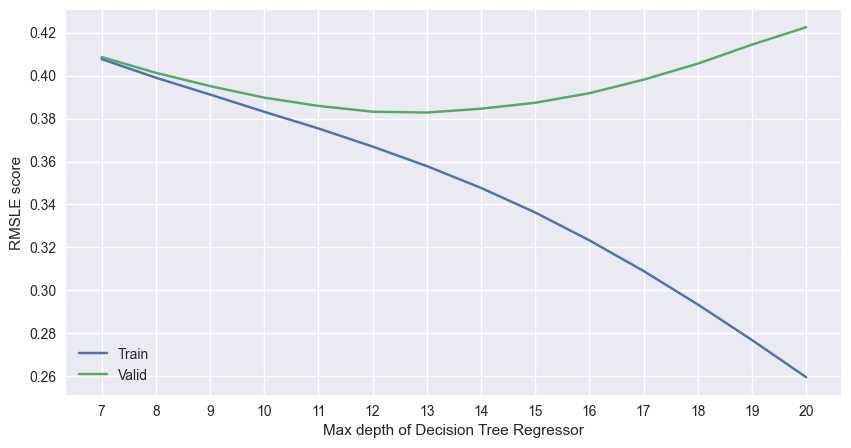

In [45]:
%%time

max_depths = range(7, 21)
train_scores, valid_scores = [], []
# Пройдемся циклом по каждой глубине
for max_depth in max_depths:
    dt = tree.DecisionTreeRegressor(max_depth=max_depth)
    dt.fit(X_train_scaled, y_train_log)
    y_train_pred = dt.predict(X_train_scaled)
    y_valid_pred = dt.predict(X_valid_scaled)
    train_scores.append(np.sqrt(metrics.mean_squared_error(y_train_log, y_train_pred)))
    valid_scores.append(np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_pred)))

# Рисуем графику по получившимся точкам
fig, ax = plt.subplots(figsize=(10, 5))
sns.lineplot(x=max_depths, y=train_scores, label='Train')
sns.lineplot(x=max_depths, y=valid_scores, label='Valid')
ax.set_xlabel('Max depth of Decision Tree Regressor')
ax.set_ylabel('RMSLE score');

---

## 6. Решение задачи регрессии: ансамблевые методы и построение прогноза

Переходим к тяжелой артиллерии: ансамблевым алгоритмам. 

### 6.1. Случайный лес

Построим модель случайного леса на обучающей выборке. В качестве гиперпараметров укажем следующие:
* n_estimators=200,
* max_depth=12,
* criterion='squared_error',
* min_samples_split=20,
* random_state=42

In [46]:
%%time
# Инициализируем объект RandomForestRegressor
rf = ensemble.RandomForestRegressor(
    n_estimators=200,
    max_depth=12,
    criterion='squared_error',
    min_samples_split=20,
    random_state=42,
    n_jobs=-1
)
# Обучение
rf.fit(X_train_scaled, y_train_log)
# Предсказание
y_train_rf_pred = rf.predict(X_train_scaled)
y_valid_rf_pred = rf.predict(X_valid_scaled)
# Вычисление метрики RMSLE на тренировочной и валидационной выборках
rf_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_rf_pred))
rf_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_rf_pred))
# Вывод метрики RMSLE, округленной до сотых
print(f"RMSLE на тренировочной выборке: {rf_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {rf_rmsle_valid:.4f}")

RMSLE на тренировочной выборке: 0.3580
RMSLE на валидационной выборке: 0.3695
Wall time: 5min 44s


Благодаря параллельному обучению нескольких деревьев модель случайного леса дала нам прирост качества по сравнению с обычным деревом решений.

Посмотрим, что будет при последовательном ансамблировании.

### 6.2. Градиентный бустинг

Построим модель градиентного бустинга над деревьями решений на обучающей выборке. В качестве гиперпараметров укажем следующие:
* learning_rate=0.5,
* n_estimators=100,
* max_depth=6, 
* min_samples_split=30,
* random_state=42

In [47]:
%%time
# Инициализируем объект GradientBoostingRegressor
gb = ensemble.GradientBoostingRegressor(
    learning_rate=0.5,
    n_estimators=100,
    max_depth=6,
    min_samples_split=30,
    random_state=42,
    verbose=True
)
# Обучение
gb.fit(X_train_scaled, y_train_log)
# Предсказание
y_train_gb_pred = gb.predict(X_train_scaled)
y_valid_gb_pred = gb.predict(X_valid_scaled)
# Вычисление метрики RMSLE на тренировочной и валидационной выборках
gb_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_gb_pred))
gb_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_gb_pred))
# Вывод метрики RMSLE, округленной до сотых
print(f"RMSLE на тренировочной выборке: {gb_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {gb_rmsle_valid:.4f}")

      Iter       Train Loss   Remaining Time 
         1           0.2798           12.41m
         2           0.1938           12.19m
         3           0.1661           12.12m
         4           0.1546           12.01m
         5           0.1482           11.83m
         6           0.1443           11.71m
         7           0.1408           11.53m
         8           0.1378           11.39m
         9           0.1362           11.29m
        10           0.1345           11.18m
        20           0.1251            9.74m
        30           0.1199            8.55m
        40           0.1173            7.27m
        50           0.1148            6.01m
        60           0.1126            4.79m
        70           0.1107            3.59m
        80           0.1091            2.38m
        90           0.1077            1.18m
       100           0.1064            0.00s
RMSLE на тренировочной выборке: 0.3261
RMSLE на валидационной выборке: 0.3452
Wall time: 11min 52s


Построим столбчатую диаграмму коэффициентов значимости каждого из факторов.

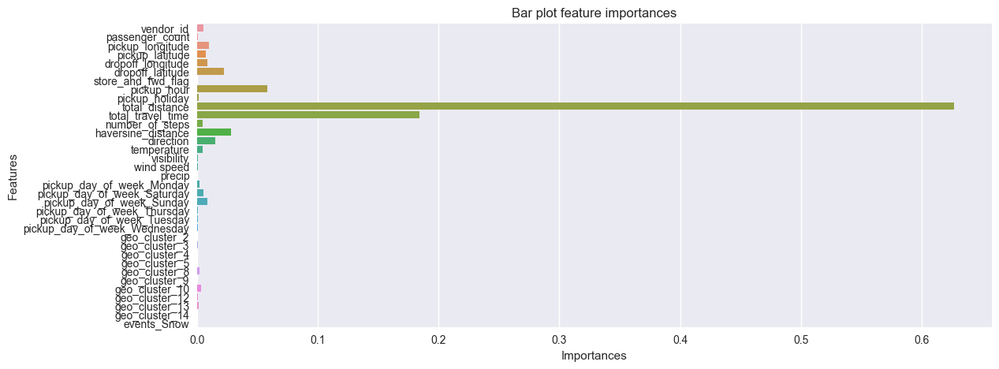

In [48]:
# Задаем фигуру
fig, ax = plt.subplots(figsize=(13, 5))
feature = X.columns 
feature_importances = gb.feature_importances_
# Рисуем столбчатую диаграмму
sns.barplot(x=feature_importances, y=best_features, orient='h', ax=ax)
ax.set_title('Bar plot feature importances')
ax.set_ylabel('Features')
ax.set_xlabel('Importances');

Наибольшую роль в описании данных сыграли osrm-признаки.

### 6.3. Расчет и интерпретация метрики MAE

Несмотря на все преимущества, у метрики RMSLE есть один недостаток — она не является интерпретируемой. Нам хотелось бы понять, насколько наша итоговая модель хорошо предсказывает целевой признак с точки зрения бизнес-процесса. Точнее, мы бы хотели получить более понятное представление об ошибке прогноза длительности поездки.

Рассчитаем медианную абсолютную ошибку (MeAE - в sklearn функция median_absolute_error) предсказания длительности поездки такси на валидационной выборке для градиентного бустинга:

$$ MeAE = median(|y_i-\hat{y_i}|)$$

In [49]:
# Преобразуем обратно логарфмированный вектор целевого признака
y_valid = np.exp(y_valid_log) - 1
# Преобразуем также предсказание модели для валидационной выборки
y_valid_gb_pred = np.exp(gb.predict(X_valid_scaled)) - 1
# Выведем метрику
print(f'Valid MAE score {metrics.median_absolute_error(y_valid, y_valid_gb_pred)/60:.2f}')

Valid MAE score 1.81


В среднем наша модель предсказывает длительность поездки с погрешновстью почти в две секунды.

### 6.4. Загрузка и преобразование тестовых данных

Прочитаем тестовые данные и заранее выделим столбец с идентификаторами поездок из тестового набора данных. Он нам еще пригодится:

In [50]:
test_data = pd.read_csv("data/test.zip")
osrm_data_test = pd.read_csv("data/osrm_data_test.zip")
test_id = test_data['id']

Перед созданием прогноза для тестовой выборки необходимо произвести все манипуляции с данными, которые мы производили с тренировочной выборкой, а именно:
* Перевести признак pickup_datetime в формат datetime;
* Добавить новые признаки (временные, географические, погодные и другие факторы);
* Произвести очистку данных от пропусков;
* Произвести кодировку категориальных признаков:
    * Закодировать бинарные признаки;
    * Закодировать номинальные признаки с помощью обученного на тренировочной выборке OneHotEncoder’а;
* Сформировать матрицу наблюдений, оставив в таблице только те признаки, которые были отобраны с помощью SelectKBest;
* Нормализовать данные с помощью обученного на тренировочной выборке MinMaxScaler’а.


In [51]:
test_data['pickup_datetime']=pd.to_datetime(test_data['pickup_datetime'],format='%Y-%m-%d %H:%M:%S')
test_data = add_datetime_features(test_data)
test_data = add_holiday_features(test_data, holiday_data)
test_data = add_osrm_features(test_data, osrm_data_test)
test_data = add_geographical_features(test_data)
test_data = add_cluster_features(test_data, kmeans)
test_data = add_weather_features(test_data, weather_data)
test_data = fill_null_weather_data(test_data)

test_data['vendor_id'] = test_data['vendor_id'].apply(lambda x: 0 if x == 1 else 1)
test_data['store_and_fwd_flag'] = test_data['store_and_fwd_flag'].apply(lambda x: 0 if x == 'N' else 1)
test_data_onehot = one_hot_encoder.fit_transform(test_data[columns_to_change])
column_names = one_hot_encoder.get_feature_names_out(columns_to_change)
test_data_onehot = pd.DataFrame(test_data_onehot, columns=column_names)

test_data = pd.concat(
    [test_data.reset_index(drop=True).drop(columns_to_change, axis=1), test_data_onehot], 
    axis=1
)
X_test = test_data[best_features]
X_test_scaled = scaler.transform(X_test)
print('Shape of data: {}'.format(X_test.shape))

Shape of data: (625134, 35)


Только после выполнения всех этих шагов можно сделать предсказание длительности поездки для тестовой выборки. Не забудем также перевести предсказания из логарифмического масштаба в истинный, используя формулу:

$$y_i=exp(z_i)-1$$

После того, как сформируем предсказание длительности поездок на тестовой выборке нам необходимо будет создать submission-файл в формате csv, чтобы сверить результат с истинными значениями на странице соревнования Kaggle и получить результирующую метрику RMSLE на тестовой выборке.

Создадим submission-файл для градиентного бустинга:

In [52]:
model = gb
y_test_predict = np.exp(model.predict(X_test_scaled)) - 1
submission = pd.DataFrame({'id': test_id, 'trip_duration': y_test_predict})
submission.to_csv('data/submission_gb.csv', index=False)

### 6.5. XGBoost

Попробуем улучшить свое предсказание, воспользовавшись моделью экстремального градиентного бустинга (XGBoost) из библиотеки xgboost.

**XGBoost** - современная модель машинного обучения, которая является продолжением идеи градиентного бустинга Фридмана. У нее есть несколько преимуществ по сравнению с классической моделью градиентного бустинга из библиотеки sklearn: повышенная производительность путем параллелизации процесса обучения, повышенное качество решения за счет усовершенствования алгоритма бустинга, меньшая склонность к переобучению и широкий функционал возможности управления параметрами модели.

Перед обучением модели необходимо перевести наборы данных в тип данных xgboost.DMatrix:

In [53]:
# Создание матриц наблюдений в формате DMatrix
dtrain = xgb.DMatrix(X_train_scaled, label=y_train_log, feature_names=list(best_features))
dvalid = xgb.DMatrix(X_valid_scaled, label=y_valid_log, feature_names=list(best_features))
dtest = xgb.DMatrix(X_test_scaled, feature_names=list(best_features))

Обучение модели XGBoost происходит с помощью метода train, в который необходимо передать параметры модели, набор данных, количество базовых моделей в ансамбле, а также дополнительные параметры:


In [54]:
%%time
# Гиперпараметры модели
xgb_pars = {'min_child_weight': 20, 'eta': 0.1, 'colsample_bytree': 0.9, 
            'max_depth': 6, 'subsample': 0.9, 'lambda': 1, 'nthread': -1, 
            'booster' : 'gbtree', 'eval_metric': 'rmse', 'objective': 'reg:squarederror'
           }
# Тренировочная и валидационная выборка
watchlist = [(dtrain, 'train'), (dvalid, 'valid')]
# Обучаем модель XGBoost
xgb_model = xgb.train(
    params=xgb_pars, #гиперпараметры модели
    dtrain=dtrain, #обучающая выборка
    num_boost_round=300, #количество моделей в ансамбле
    evals=watchlist, #выборки, на которых считается матрица
    early_stopping_rounds=20, #раняя остановка
    maximize=False #смена поиска максимума на минимум
)

[0]	train-rmse:0.72020	valid-rmse:0.71978
[10]	train-rmse:0.45745	valid-rmse:0.45754
[20]	train-rmse:0.39963	valid-rmse:0.40015
[30]	train-rmse:0.38181	valid-rmse:0.38262
[40]	train-rmse:0.37273	valid-rmse:0.37383
[50]	train-rmse:0.36597	valid-rmse:0.36731
[60]	train-rmse:0.36149	valid-rmse:0.36312
[70]	train-rmse:0.35789	valid-rmse:0.35976
[80]	train-rmse:0.35513	valid-rmse:0.35739
[90]	train-rmse:0.35303	valid-rmse:0.35556
[100]	train-rmse:0.35118	valid-rmse:0.35400
[110]	train-rmse:0.34930	valid-rmse:0.35246
[120]	train-rmse:0.34776	valid-rmse:0.35126
[130]	train-rmse:0.34652	valid-rmse:0.35024
[140]	train-rmse:0.34545	valid-rmse:0.34945
[150]	train-rmse:0.34432	valid-rmse:0.34863
[160]	train-rmse:0.34323	valid-rmse:0.34782
[170]	train-rmse:0.34220	valid-rmse:0.34707
[180]	train-rmse:0.34146	valid-rmse:0.34655
[190]	train-rmse:0.34040	valid-rmse:0.34589
[200]	train-rmse:0.33938	valid-rmse:0.34522
[210]	train-rmse:0.33849	valid-rmse:0.34467
[220]	train-rmse:0.33773	valid-rmse:0.34418

In [55]:
# Делаем предсказание на тестовом наборе данных
y_test_xgb_pred = np.exp(xgb_model.predict(dtest)) - 1
y_train_xgb_pred = xgb_model.predict(dtrain)
xgb_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_xgb_pred))
print('Train RMSLE %.5f', round(xgb_rmsle_train, 5))
print('Modeling RMSLE %.5f' % xgb_model.best_score)
# Делаем сабмит
submission = pd.DataFrame({'id': test_id, 'trip_duration': y_test_xgb_pred})
submission.to_csv('data/submission_xgb.csv', index=False)

Train RMSLE %.5f 0.33248
Modeling RMSLE 0.34152


Также как и все модели, основанные на использовании деревьев решений в качестве базовых моделей, XGBoost имеет возможность определения коэффициентов важности факторов. Более того, в библиотеку встроена возможность визуализации важность факторов в виде столбчатой диаграммы. За эту возможность отвечает функция plot_importance():


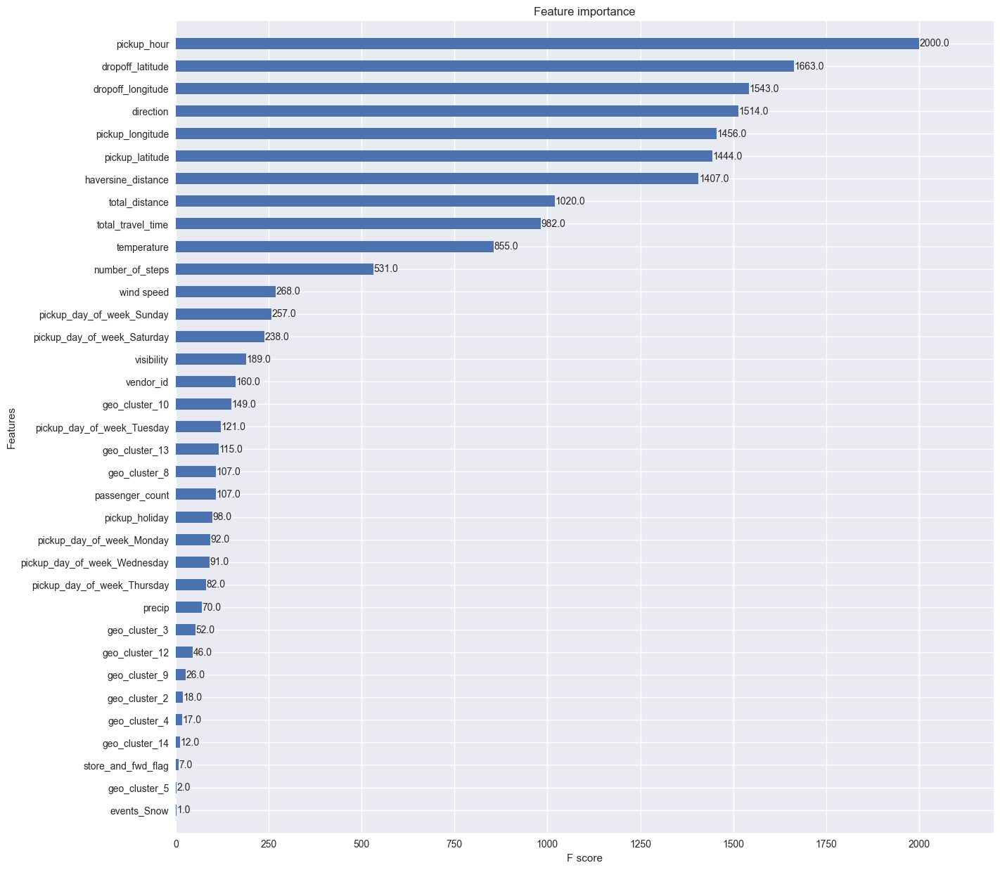

In [56]:
fig, ax = plt.subplots(figsize = (15,15))
xgb.plot_importance(xgb_model, ax = ax, height=0.5);

### 6.6. CatBoost

Попробуем также прогнать CatBoostRegressor. Этот инструмент в целом более удобный: обладает реализацией по типу sklearn + довольно хорошие дефолтные гиперпараметры.

In [57]:
%%time
# Заводим модель
cbr = CatBoostRegressor(random_state=42, verbose=False)
# Обучаем.
cbr.fit(X_train_scaled, y_train_log)
# Предсказываем
y_train_cbr_pred = cbr.predict(X_train_scaled)
y_valid_cbr_pred = cbr.predict(X_valid_scaled)
# Вычисление метрики RMSLE на тренировочной и валидационной выборках
cbr_rmsle_train = np.sqrt(metrics.mean_squared_error(y_train_log, y_train_cbr_pred))
cbr_rmsle_valid = np.sqrt(metrics.mean_squared_error(y_valid_log, y_valid_cbr_pred))
# Вывод метрики RMSLE, округленной до сотых
print(f"RMSLE на тренировочной выборке: {cbr_rmsle_train:.4f}")
print(f"RMSLE на валидационной выборке: {cbr_rmsle_valid:.4f}")

RMSLE на тренировочной выборке: 0.3291
RMSLE на валидационной выборке: 0.3385
Wall time: 34.5 s


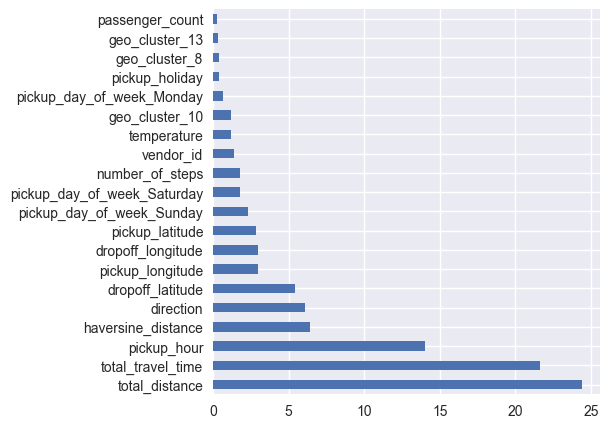

In [58]:
# Выведем самые важные признаки для модели
plt.rcParams['figure.figsize'] = (5,5)
feat_importances = pd.Series(cbr.feature_importances_, index=best_features)
feat_importances.nlargest(20).plot(kind='barh');

In [59]:
# Делаем сабмит
y_test_cbr_pred = np.exp(cbr.predict(X_test_scaled)) - 1
submission = pd.DataFrame({'id': test_id, 'trip_duration': y_test_cbr_pred})
submission.to_csv('data/submission_cbr.csv', index=False)

---

## 7. Итог

Сведем в одну таблицу метрики RMSLE всех использованных нами моделей.

In [60]:
results_df = pd.DataFrame(
    data=[
        np.round([
            rmsle_train, poly_rmsle_train,
            ridge_rmsle_train, dt_rmsle_train,
            dtgs_rmsle_train, rf_rmsle_train,
            gb_rmsle_train, xgb_rmsle_train,
            cbr_rmsle_train
        ], 4),
        np.round([
            rmsle_valid, poly_rmsle_valid,
            ridge_rmsle_valid, dt_rmsle_valid,
            dtgs_rmsle_valid, rf_rmsle_valid,
            gb_rmsle_valid, xgb_model.best_score,
            cbr_rmsle_valid
        ], 4)
    ],
    columns=[
        'LR', 'LR-poly', 'Ridge',
        'DTR', 'DTR-GS', 'RFR',
        'GBR', 'XGB', 'CBR'
    ],
    index=['RMSLE train', 'RMSLE valid']
)

results_df

,LR,LR-poly,Ridge,DTR,DTR-GS,RFR,GBR,XGB,CBR
RMSLE train,0.4946,0.4172,0.4297,0.0029,0.3670,0.3580,0.3261,0.3325,0.3291
RMSLE valid,0.4944,1.3240,0.4294,0.4908,0.3834,0.3695,0.3452,0.3415,0.3385


Модель на основе алгоритма CatBoostRegressor показала себя лучше остальных.